<a href="https://colab.research.google.com/github/DarkNightSoldier/AudioProcessing/blob/master/Procesamiento_Audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Módulo Audioprocessing para el procesamiento de Audio

La demostración del módulo consta de 6 partes:
1) Reproducción lenta del audio, el usuario deberá definir qué tan lenta quiere la reproducción.
2) Reproducción rápida del audio, el usuario deberá definir qué tan rápida quiere la reproducción, 3) Reproducción hacia atrás del audio 
4) Limpiar el audio de ruido de alta frecuencia, 5) Ecualización de las frecuencias bajas y altas del audio.
6) Mezclar dos audios en el mismo archivo.

#Módulo audioprocessing.py

El notebook fue diseñado bajo los parámetros de diseño modular, pensando en un código limpio, entendible y fácil de reutilizar.

In [171]:
from scipy.io import wavfile
import numpy as np
import IPython.display as ipd
from scipy.fftpack import *
import matplotlib.pyplot as plt
import math

def playAudio(file):
    """
    Muestra en pantalla el reproductor de iPython Display para un archivo de
    formato .wav.

    Parámetros
    ----------
    file: string
        Nombre del archivo en formato .wav que contiene audio en formato
        mono o estéreo.
    """
    return ipd.Audio(file)

def ReadAudio(file):
    """
    Retorna la tasa de muestras por minuto y la matriz con los datos del audio}
    en formato mono o estéreo.

    Parámetros
    ----------
    file: string
        Nombre del archivo en formato .wav que contiene audio en formato
        mono o estéreo.
        
    Retorna
    --------
    List: 
        [rate,data]
    rate: int 
        Muestras por segundo
    data: numpy ndarray 
        Matriz con audio en mono o estéreo
    """
    rate,data=wavfile.read(file)
    return [rate,data]

def WriteAudio(filename,rate,matrix):
    """
    Escribe un archivo de audio .wav a partir de una matriz numpy con los datos
    del audio en mono o estéreo y la tasa de muestras por segundo.

    Parámetros
    ----------
    filename: string
        Nombre del archivo de salida .wav.
    matrix: numpy ndarray
        Matriz con audio en mono o estéreo.
    rate: int
        Tasa de muestras por minuto del audio.
    
    Retorna
    --------
    List: 
        [rate,data]
    rate: int 
        Muestras por segundo
    data: numpy ndarray 
        Matriz con audio en mono o estéreo
    """
    wavfile.write(filename,rate,matrix)

def Speed_Rep(input_filename,speed,output_filename):
    """
    Muestra en pantalla el reproductor de audio y guarda el audio con la
    velocidad dada por el usuario para el archivo .wav estipulado.

    Parámetros
    ----------
    input_filename: string
         Nombre o localización/path del archivo .wav de entrada.
    speed: float
        Velocidad con la que se va a reproducir el audio de destino.
    output_filename: string
         Nombre o localización/path del archivo .wav de salida
    
    Retorna
    ----------
    Reproductor en pantalla de iPython con el audio con la velocidad deseada.

    """
    rate,data=ReadAudio(input_filename)
    WriteAudio(output_filename,int(rate*speed),data)
    print(f"El archivo se guardo con éxito como {output_filename}")
    return playAudio(output_filename)

def Inverse_Rep(input_filename,output_filename):
    """
    Muestra en pantalla el reproductor de audio y guarda el audio reproducido
    desde atrás en el archivo .wav estipulado.

    Parámetros
    ----------
    input_filename: string
         Nombre o localización/path del archivo .wav de entrada.
    output_filename: string
         Nombre o localización/path del archivo .wav de salida
    """
    
    rate,data=ReadAudio(input_filename)
    #Convertimos a mono el audio original
    data=ConvertToMono(data)
    #Leemos la matriz desde atrás usando la notación de slicing de listas
    WriteAudio(output_filename,rate,data[::-1])
    print(f"El archivo se guardo con éxito como {output_filename}")
    return playAudio(output_filename)

def ConvertToMono(data):
    """
    Retorna un array de Numpy con la matriz de audio convertida a mono con el
    mismo dtype de Numpy que el original.

    Parámetros
    ----------
    data: numpy ndarray
        Matriz de Numpy que contiene audio en formato mono o estéreo.
    
    Retorna
    ----------
    mono: numpy ndarray
        Matriz de Numpy que contiene audio en mono.
    """
    #Se procede a leer el audio
    if len(data.shape)==1:
        canales=1
    else:  
        canales=data.shape[1]

    if canales==1:
        mono=data
    #En caso de que el audio sea de formato estéreo procede a su conversión
    elif canales==2:
        mono=[]
        stereo_dtype=data.dtype
        #Se obtienen los vectores correspondientes a cada canal de audio
        l=data[:,0]
        r=data[:,1]
        #Se suma cada canal de audio para obtener uno solo
        for i in range(len(data)):
            d=(l[i]/2)+(r[i]/2)
            mono.append(d)
        mono=np.array(mono,dtype=stereo_dtype)
    return mono


def Lowpass(data,alpha):
    """
    Filtro exponencial EMA de paso bajo que recibe una matriz con audio en
    mono y retorna una matriz con audio en mono del mismo tipo con el Filtro
    aplicado.

    Parámetros
    ----------
    data: Matriz Numpy ndarray
         Matriz con los datos de un audio mono.
    alpha: float
         Factor entre 0 y 1 que determina el suavizado y aplicación del filtro.
    """
    f0=alpha*data[0]
    filtered=[f0]
    for i in range (1,len(data)):
        #y[i] := α * x[i] + (1-α) * y[i-1]
        f=alpha*data[i]+(1-alpha)*filtered[i-1]
        filtered.append(f)
    return np.array(filtered,dtype=data.dtype)

def Highpass(data,alpha):
    """
    Filtro exponencial EMA de paso alto que recibe una matriz con audio en
    mono y retorna una matriz con audio en mono del mismo tipo con el Filtro
    aplicado.

    Parámetros
    ----------
    data: Matriz Numpy ndarray
         Matriz con los datos de un audio mono.
    alpha: float
         Factor entre 0 y 1 que determina el suavizado y aplicación del filtro.
    """
    f_Lowpass=Lowpass(data,alpha)
    filtered=[]
    for i in range(len(data)):
        f=data[i]-f_Lowpass[i]
        filtered.append(f)
    return np.array(filtered,dtype=data.dtype)

def Frequency_Cutoff(type,frequency,input_filename,output_filename):
    """
    Aplica el filtro exponencial EMA de acuerdo al tipo especificado por el
    usuario (Lowpass o Highpass).

    Parámetros
    ----------
    type: string (low or high)
        Tipo de filtro (Paso bajo o paso alto).
    frequency: float
        Frecuencia (Hz) de corte para aplicación de filtro.
    input_filename: string
         Nombre o localización/path del archivo .wav de entrada.
    output_filename: string
         Nombre o localización/path del archivo .wav de salida
    """
    rate,data=ReadAudio(input_filename)
    dt=1/rate
    RC=1/(2*math.pi*frequency)
    alpha=dt/(dt+RC)

    print(alpha)
    
    if type=="low":
        data_f=Lowpass(data,alpha)
    elif type=="high":
        data_f=Highpass(data,alpha)
    WriteAudio(output_filename,rate,data_f)
    print(f"El archivo se guardo con éxito como {output_filename}")

def FFT_Graphing(Graph_Title,data_1,rate_1,audio1_title,data_2,rate_2,audio2_title):
    """
    Grafica la transformada de fourier de dos audios, donde el eje x se
    muestra como la frecuencia en Hertz y el eje y la amplitud. Esto permite
    comparar de manera objetiva dos audios en su dominio frecuencia.

    Parámetros
    ----------
    Graph_Title: string
        Título de la gráfica.
    data_1: numpy ndarray
        Matriz con audio en mono.
    rate_1: int
        Muestras por segundo del audio.
    audio1_title: string
        Nombre a mostrar en la gráfica.
    data_2: numpy ndarray
        Matriz con audio en mono.
    rate_2: int
            Muestras por segundo del audio.
    audio2_title: string
        Nombre a mostrar en la gráfica.
    """
    plt.title(Graph_Title)
    plt.xlabel("Frecuencia (Hz)")
    plt.ylabel("Amplitud")

    fft_data_1=abs(fft(data_1))
    frecs_1=fftfreq(len(fft_data_1),(1/rate_1))
    x1=frecs_1[:(len(fft_data_1)//2)]
    y1=fft_data_1[:(len(fft_data_1)//2)]

    fft_data_2=abs(fft(data_2))
    frecs_2=fftfreq(len(fft_data_2),(1/rate_2))
    x2=frecs_2[:(len(fft_data_2)//2)]
    y2=fft_data_2[:(len(fft_data_2)//2)]

    plt.plot(x1,y1,color="r",label=audio1_title)
    plt.plot(x2,y2,color="g",label=audio2_title)
    plt.legend(loc='upper right', borderaxespad=0.)
    plt.show()

In [1]:
! git clone https://github.com/DarkNightSoldier/AudioProcessing.git
!mv ./AudioProcessing/Happy.wav ./
!mv ./AudioProcessing/sweet.wav ./
!mv ./AudioProcessing/ruido.wav ./

Cloning into 'AudioProcessing'...
remote: Enumerating objects: 70, done.
remote: Counting objects: 100% (70/70), done.
remote: Compressing objects: 100% (59/59), done.
remote: Total 70 (delta 35), reused 28 (delta 8), pack-reused 0
Unpacking objects: 100% (70/70), done.


# 1. Reproducción lenta del audio

In [44]:
Velocidad = 0.9 #@param {type:"slider", min:0.4, max:1, step:0.05}
Speed_Rep("Happy.wav",Velocidad,"slow.wav")

El archivo se guardo con éxito como slow.wav


# 2. Reproducción rapida del audio

In [46]:
Velocidad = 1.65 #@param {type:"slider", min:1, max:5, step:0.05}
Speed_Rep("Happy.wav",Velocidad,"fast.wav")

El archivo se guardo con éxito como fast.wav


# 3. Reproducción hacia atrás del audio

In [62]:
Inverse_Rep("Happy.wav","inverse.wav")

El archivo se guardo con éxito como inverse.wav


#4. Limpieza del ruido de alta frecuencia

In [242]:
fr=4200
Frequency_Cutoff("low",fr,"tono.wav","limpio.wav")

0.3743738266711348
El archivo se guardo con éxito como limpio.wav


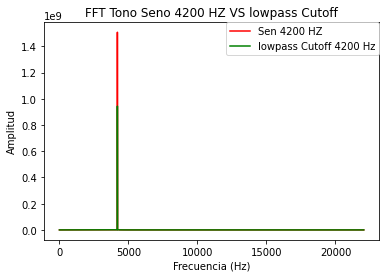

In [243]:
rate_1,data_1=ReadAudio("tono.wav")
data_1=ConvertToMono(data_1)

rate_2,data_2=ReadAudio("limpio.wav")
data_2=ConvertToMono(data_2)

FFT_Graphing("FFT Tono Seno 4200 HZ VS lowpass Cutoff",data_1,rate_1,"Sen 4200 HZ",data_2,rate_2,f"lowpass Cutoff {fr} Hz")

In [238]:
playAudio("tono.wav")

In [239]:
playAudio('limpio.wav')

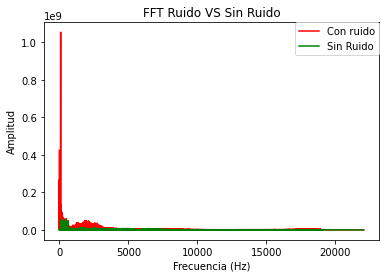

In [123]:
rate_1,data_1=ReadAudio("ruido.wav")
data_1=ConvertToMono(data_1)

rate_2,data_2=ReadAudio("SinRuido.wav")
data_2=ConvertToMono(data_2)


FFT_Graphing("FFT Ruido VS Sin Ruido",data_1,rate_1,"Con ruido",data_2,rate_2,"Sin Ruido")

In [117]:
playAudio('ruido.wav')

#5. Ecualización de frecuencias altas y bajas

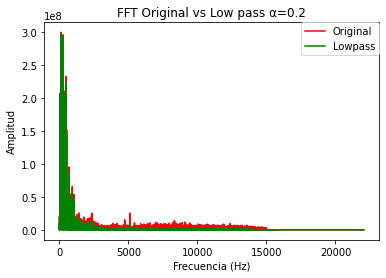

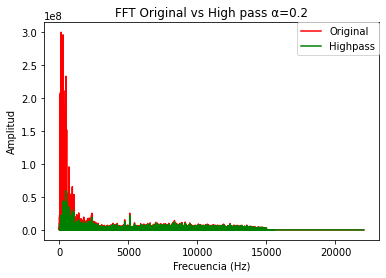

In [139]:
alpha = 0.2 #@param {type:"slider", min:0, max:1, step:0.01}
rate,data=ReadAudio("Happy.wav")
data=ConvertToMono(data)

data_low=Lowpass(data,alpha)
data_high=Highpass(data,alpha)

FFT_Graphing(f"FFT Original vs Low pass α={alpha}",data,rate,"Original",data_low,rate,"Lowpass")
FFT_Graphing(f"FFT Original vs High pass α={alpha}",data,rate,"Original",data_high,rate,"Highpass")

In [140]:
print(f"Lowpass α={alpha}")
WriteAudio("lowpass.wav",rate,data_low)
playAudio("lowpass.wav")

Lowpass α=0.2


In [141]:
print(f"Highpass α={alpha}")
WriteAudio("highpass.wav",rate,data_high)
playAudio("highpass.wav")

Highpass α=0.2


#6. Combinar dos audios

In [152]:
rate_s2,data_s2 = wavfile.read('sweet.wav')
data_s2=ConvertToMono(data_s2)

In [157]:
import numpy as np
data_s1=data
rate_s1=rate
if len(data_s1)>len(data_s2):
    base_data=data_s1.copy()
    insert_data=data_s2.copy()
else:
    base_data=data_s2.copy()
    insert_data=data_s1.copy()

for i in range (0,int(len(insert_data))):
    base_data[i]=base_data[i]/2+insert_data[i]/2

wavfile.write("combined.wav",int((rate_s2+rate_s1)/2),base_data)
ipd.Audio('combined.wav')